# Read landmarks (points) and KL-grades 

* `V00`: baseline/enrollment visit
* `pts`: computed by the BoneFinder. There are 74 points for each knee.

In [ ]:
import numpy as np
import os
import re # For parsing the .pts file
import matplotlib.pyplot as plt
# import seaborn as sns # For potentially nicer plots
import pandas as pd # Useful for data handling and plotting
import cv2
import pydicom

# --- Configuration ---
# !! IMPORTANT: Update these paths to match your system !!
IMAGE_DIR = "D:/V00/Bilateral_PA_Fixed_Flexion_Knee" # Directory containing OAI DICOM 
PTS_DIR = "D:/V00/Points_px" # Directory containing .pts landmark files from landmark detector, e.g., BoneFinder
TXT_FILE_PATH = "D:/V00/kxr_sq_bu00.txt" # Path to the master TXT file
KL_GRADE_COLUMN = "V00XRKL" # The actual column name for KL grade in your TXT file (e.g., 'V00XRKL' for OAI)
# Use a specific file extension if needed, e.g., "*.png", "*.dcm"
# If filenames *are* the IDs without extensions, use os.listdir directly.
# Assuming filenames might have extensions like .png, .dcm etc.
EXPECTED_LANDMARKS_PER_KNEE = 74
TOTAL_LANDMARKS = EXPECTED_LANDMARKS_PER_KNEE * 2

# --- Provided Function ---
def get_values_by_id(txt_file, search_id, column_name):
    """
    Retrieve two values for SIDE=1 (right) and SIDE=2 (left) where READPRJ=15 for a given ID.
    If READPRJ=15 is not found, fallback to READPRJ=37 or READPRJ=42.

    Parameters:
    - txt_file: numpy array containing the text data.
    - search_id: str, the ID to search for (first column).
    - column_name: str, the name of the column to retrieve value from.

    Returns:
    - Tuple (value_for_SIDE_1, value_for_SIDE_2) or -1 if not found.
    """
    # Extract header row (first row)
    headers = txt_file[0]

    # Find column indices
    # Convert headers to uppercase for case-insensitive checking
    headers_upper = [header.upper() for header in headers] # some headers are in lowercases
    if column_name not in headers_upper:
        print(f"Column '{column_name}' not found!")
        return None, None


    col_index = np.where(np.char.upper(headers) == column_name)[0][0]  # Target column
    side_index = np.where(headers == "SIDE")[0][0]  # 'SIDE' column index
    readprj_index = np.where(np.char.upper(headers) == "READPRJ")[0][0]  # 'READPRJ' column index; some will be in lowercase

    # Try priority READPRJ values in order: 15 → 37 → 42
    readprj_priority = ["15", "37", "42"]
    
    value_1, value_2 = None, None  # Variables to store values

    for readprj in readprj_priority:
        for row in txt_file[1:]:  # Skip header row
            if row[0] == search_id and row[readprj_index] == readprj:  # Match ID and READPRJ
                if row[side_index] == "1":
                    value_1 = row[col_index]
                elif row[side_index] == "2":
                    value_2 = row[col_index]
        
        # If both SIDE=1 and SIDE=2 are found, stop searching
        if value_1 is not None and value_2 is not None:
            if readprj != "15":
                print(f"Using READPRJ={readprj} for ID {search_id} because READPRJ=15 is missing.")
            break
    
    # Handle empty strings and convert to int safely
    def safe_int(value):
        return int(value) if value and value.strip() != '' else None

    value_1 = safe_int(value_1)
    value_2 = safe_int(value_2)

    # If any value is still missing, print a warning
    if value_1 is None:
        print(f"Data missing for ID {search_id}: SIDE=1 not found in READPRJ=15, 37, or 42!")
        value_1 = -999
    if value_2 is None:
        print(f"Data missing for ID {search_id}: SIDE=2 not found in READPRJ=15, 37, or 42!")
        value_2 = -999

    return value_1, value_2

    



# --- Function to Read .pts File ---
def read_pts_file(filepath, expected_points):
    """Reads landmark points from a .pts file."""
    points = []
    try:
        with open(filepath, 'r') as f:
            lines = f.readlines()
            
        # Find lines between { and }
        start_index = -1
        end_index = -1
        for i, line in enumerate(lines):
            if line.strip() == '{':
                start_index = i + 1
            elif line.strip() == '}':
                end_index = i
                break
        
        if start_index == -1 or end_index == -1 or start_index >= end_index:
             print(f"Warning: Could not find valid {{ ... }} block in {filepath}")
             return None

        point_lines = lines[start_index:end_index]
        
        for line in point_lines:
            line = line.strip()
            if not line: # Skip empty lines
                continue
            try:
                # Use regex to find floating point numbers, robust to extra spaces
                coords = re.findall(r"[-+]?\d*\.\d+|[-+]?\d+", line)
                if len(coords) == 2:
                    points.append([float(coords[0]), float(coords[1])])
                else:
                    print(f"Warning: Skipping malformed line in {filepath}: '{line}'")
            except ValueError:
                print(f"Warning: Could not parse line in {filepath}: '{line}'")
                continue # Skip lines that can't be parsed

        if len(points) != expected_points:
            print(f"Warning: Expected {expected_points} points, but found {len(points)} in {filepath}")
            # Decide how to handle this: return None, return partial data, raise error?
            # Returning None is safer if exact number is critical.
            return None 
            
        return np.array(points) # Shape: (expected_points, 2)

    except FileNotFoundError:
        print(f"Error: PTS file not found: {filepath}")
        return None
    except Exception as e:
        print(f"Error reading PTS file {filepath}: {e}")
        return None

# --- Main Processing Logic ---

# 1. Get Patient IDs from filenames in IMAGE_DIR
try:
    # List all items in the directory
    all_files = os.listdir(IMAGE_DIR)
    # Example: Assume filenames are like '9000001.png'. Extract '9000001'.
    # Adjust the splitting logic if your filenames are different.
    patient_ids = sorted([os.path.splitext(f)[0] for f in all_files if os.path.isfile(os.path.join(IMAGE_DIR, f))])
    # Basic check if IDs look reasonable (e.g., numeric) - adjust if needed
    patient_ids = [pid for pid in patient_ids if pid.isdigit()] 
    print(f"Found {len(patient_ids)} potential patient IDs.")
    if not patient_ids:
         raise ValueError("No valid patient IDs found. Check IMAGE_DIR and filename format.")
except FileNotFoundError:
    print(f"Error: IMAGE_DIR not found: {IMAGE_DIR}")
    patient_ids = []
except Exception as e:
    print(f"Error listing patient IDs: {e}")
    patient_ids = []
    
# 2. Load the master TXT file
try:
    # Use genfromtxt for better handling of potential issues like missing values or mixed types
    # Using delimiter='\t' assuming tab-separated; change if it's space or comma etc.
    # dtype=str to read everything as string initially
    # comments='#' or None if no comment lines expected
    # txt_data = np.genfromtxt(TXT_FILE_PATH, delimiter='\t', dtype=str, skip_header=0, comments=None, invalid_raise=False)
    txt_data = np.loadtxt(TXT_FILE_PATH, dtype=str, delimiter="|", ndmin=2)

    print(f"Successfully loaded TXT data from {TXT_FILE_PATH} with shape {txt_data.shape}")
    if txt_data.ndim == 1: # Handle case where only one row (header) or one data row exists
        txt_data = txt_data.reshape(1, -1) if len(txt_data) > 0 else np.array([[]]) # Reshape or make empty
        print(f"Reshaped TXT data shape: {txt_data.shape}")
    if txt_data.shape[0] < 2:
        print("Warning: TXT data seems to contain only headers or is empty.")
except FileNotFoundError:
    print(f"Error: TXT file not found: {TXT_FILE_PATH}")
    txt_data = None
except Exception as e:
    print(f"Error loading TXT file {TXT_FILE_PATH}: {e}")
    txt_data = None

# 3. Process each patient
all_patient_features_L = []
all_patient_features_R = []
kl_grades_L_list = []
kl_grades_R_list = []

processed_ids = []
# kl_grades_list = [] # Store tuples of (KL_left, KL_right)

if txt_data is not None and len(patient_ids) > 0:
    for patient_id in patient_ids:
        print(f"\nProcessing patient ID: {patient_id}")

        # Construct path to .pts file
        pts_filepath = os.path.join(PTS_DIR, f"{patient_id}.pts")

        # Read landmark points
        landmarks = read_pts_file(pts_filepath, TOTAL_LANDMARKS)

        if landmarks is None:
            print(f"Skipping patient {patient_id} due to issues reading landmarks.")
            continue # Skip this patient

        # Get KL grades for both knees (SIDE 1 = Right, SIDE 2 = Left based on OAI standard)
        kl_right, kl_left = get_values_by_id(txt_data, patient_id, KL_GRADE_COLUMN)

        # Decide how to handle missing KL grades (-999)
        # Option 1: Skip patient if any KL grade is missing
        # if kl_left == -999 or kl_right == -999:
        #     print(f"Skipping patient {patient_id} due to missing KL grade(s).")
        #     continue

        # Option 2: Keep patient and use -999 as a placeholder (chosen here)
        # if kl_left == -999 or kl_right == -999:
        #      print(f"Patient {patient_id} has missing KL grade(s) (L={kl_left}, R={kl_right}). Using -999 placeholder.")


        # Combine features: Flatten landmarks and append KL grades
        # landmarks shape is (148, 2). Flatten to 1D array of size 296.
        landmarks_flat = landmarks.flatten() # Order: x0L, y0L, x1L, y1L, ..., x73R, y73R

        # Create feature vector: [landmarks_flat..., kl_left, kl_right]
        # Total features = 74*2 (landmarks for each knee) + 2 (KL grades and side) = 150
        # BoneFinder: start from left side : 0->left, 1->right

        feature_vector_L = landmarks_flat[:EXPECTED_LANDMARKS_PER_KNEE*2]
        all_patient_features_L.append(feature_vector_L)
        kl_grades_L_list.append(kl_left)

        feature_vector_R = landmarks_flat[EXPECTED_LANDMARKS_PER_KNEE*2:TOTAL_LANDMARKS*2]
        all_patient_features_R.append(feature_vector_R)
        kl_grades_R_list.append(kl_right)

        processed_ids.append(patient_id)
        print(f"Successfully processed patient {patient_id}. Feature vector shape: {feature_vector_L.shape}, {feature_vector_R.shape}")



print(f"\nCollected features for {len(processed_ids)} patients.")

all_features_L_np = np.array(all_patient_features_L)
print(f"Final left knee feature matrix shape: {all_features_L_np.shape}") # (num_patients*2, 150)
all_features_R_np = np.array(all_patient_features_R)
print(f"Final right knee feature matrix shape: {all_features_R_np.shape}") # (num_patients*2, 150)

# Store KL grades separately for convenience in plotting/analysis
kl_grades_L_np = np.array(kl_grades_L_list) # Shape: (num_patients*2, 1)
kl_grades_R_np = np.array(kl_grades_R_list) # Shape: (num_patients*2, 1)

Error: IMAGE_DIR not found: D:/V00/Bilateral_PA_Fixed_Flexion_Knee
Error: TXT file not found: D:/V00/kxr_sq_bu00.txt

Collected features for 0 patients.
Final left knee feature matrix shape: (0,)
Final right knee feature matrix shape: (0,)


In [2]:
# Write a file containing only patient id, KL-grades of left and right knees at V00.
# filename = "KL_V00.txt"

# with open(filename, "w") as file:
#     file.write(f"ID,L,R\n")
#     for item1, item2, item3 in zip(patient_ids, kl_grades_L_list, kl_grades_R_list,):
#         file.write(f"{item1},{item2},{item3}\n")

In [2]:
print(all_features_R_np.shape, all_features_L_np.shape, kl_grades_L_np.shape, kl_grades_R_np.shape, len(patient_ids))

(4794, 148) (4794, 148) (4794,) (4794,) 4794


In [3]:
shapes_R = all_features_R_np
shapes_L = all_features_L_np

def transformTo2d(data):
    '''
    Transform 1d landmarks [x1, y1, x2, y2, ...] into 
    [(x1, y1), 
     (x2, y2), 
       ...   ]
    '''
    if len(data.shape) == 1:
        landmarks = data[:EXPECTED_LANDMARKS_PER_KNEE*2]
        return np.vstack((landmarks[::2], landmarks[1::2])).T

    res = []
    for d in data:
        landmarks = d[:EXPECTED_LANDMARKS_PER_KNEE*2]
        res.append(np.vstack((landmarks[::2], landmarks[1::2])).T)
    return np.array(res)

shapes_L_2d = transformTo2d(shapes_L)
shapes_R_2d = transformTo2d(shapes_R)

print(shapes_L_2d.shape, shapes_R_2d.shape)
print(patient_ids[0])
print(shapes_L_2d[0])

(4794, 74, 2) (4794, 74, 2)
9000099
[[3086.2    925.725]
 [3092.53   983.847]
 [3097.02  1045.74 ]
 [3109.    1105.68 ]
 [3124.69  1161.81 ]
 [3147.9   1219.73 ]
 [3176.66  1270.07 ]
 [3211.03  1318.47 ]
 [3217.49  1387.86 ]
 [3216.44  1457.33 ]
 [3202.23  1525.08 ]
 [3191.82  1596.55 ]
 [3147.55  1662.78 ]
 [3080.13  1676.72 ]
 [3014.37  1671.88 ]
 [2948.47  1655.76 ]
 [2886.08  1618.96 ]
 [2821.81  1582.18 ]
 [2753.86  1551.08 ]
 [2677.24  1580.15 ]
 [2606.44  1626.05 ]
 [2537.53  1671.92 ]
 [2483.25  1685.71 ]
 [2425.06  1686.4  ]
 [2370.47  1673.91 ]
 [2339.39  1586.05 ]
 [2298.87  1494.54 ]
 [2269.62  1402.9  ]
 [2264.68  1303.46 ]
 [2293.58  1207.38 ]
 [2339.94  1159.89 ]
 [2390.09  1114.24 ]
 [2442.13  1070.44 ]
 [2488.48  1021.08 ]
 [2529.12   966.153]
 [2564.12   909.416]
 [2595.31   848.971]
 [3008.54  2285.83 ]
 [3028.49  2227.39 ]
 [3046.62  2172.74 ]
 [3066.59  2116.18 ]
 [3094.1   2061.41 ]
 [3129.23  2015.93 ]
 [3162.43  1966.73 ]
 [3197.34  1902.48 ]
 [3213.38  1830.95 

In [4]:
np.savez("id_shapeLR_V00.npz", id=patient_ids, shapes_L=shapes_L_2d, shapes_R=shapes_R_2d, KL_L=kl_grades_L_np, KL_R=kl_grades_R_np)

# Visualize the landmarks on the knee x-ray

* Notice that the pixel dimensions and contrast of the images at `index = 0` and `index = 1` differ.
* This suggests we need to be cautious when selecting the patch size for cropping.
* Additionally, we should normalize or adjust the image contrast to ensure consistency.

(3560, 4320)


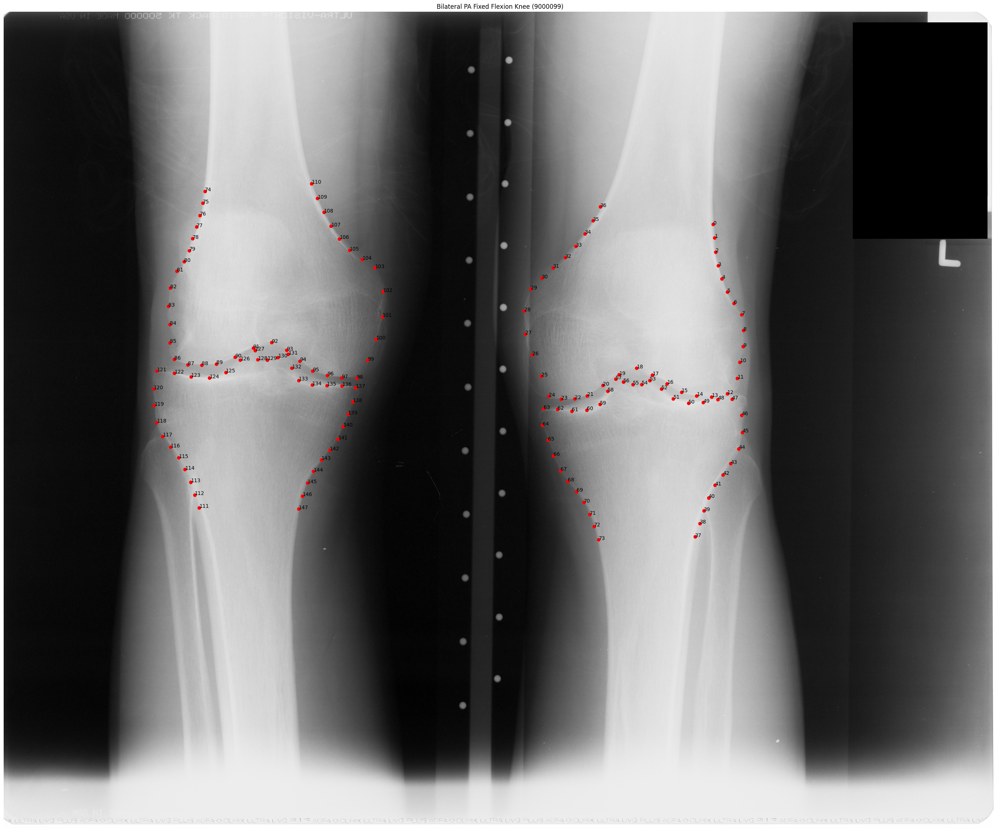

(2048, 2494)


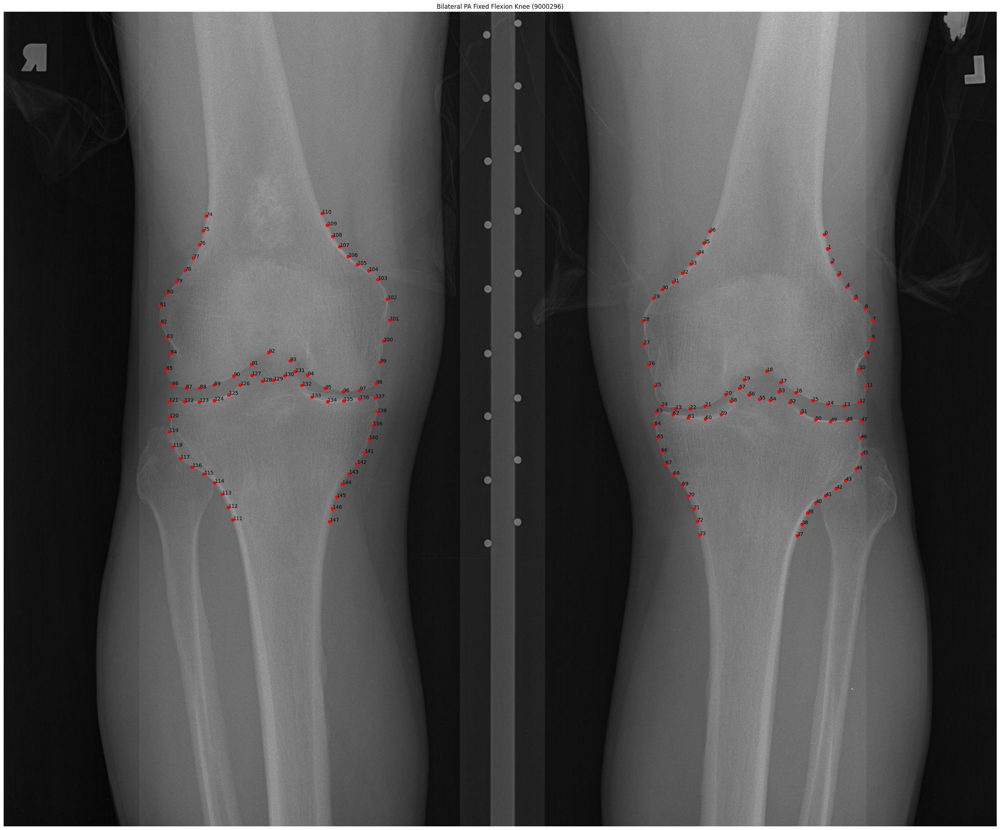

In [5]:
import pydicom
import matplotlib.pyplot as plt

index = 0

file_path = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array
# Display the image
print(image.shape)
plt.figure(figsize=(35, 43))
plt.imshow(image, cmap='gray')  # Use gray colormap for medical images
plt.axis('off')  # Hide axes
plt.title(f"{dicom_data.SeriesDescription} ({patient_ids[index]})")  # Use the Series Description as title
plt.scatter(shapes_L_2d[index][:, 0], shapes_L_2d[index][:, 1], c="red")
plt.scatter(shapes_R_2d[index][:, 0], shapes_R_2d[index][:, 1], c="red")

for i in range(len(shapes_L_2d[index])):
    plt.annotate(i, (shapes_L_2d[index][i, 0], shapes_L_2d[index][i, 1]))
    plt.annotate(i + len(shapes_L_2d[index]), (shapes_R_2d[index][i, 0], shapes_R_2d[index][i, 1]))
plt.show()

index = 1

file_path = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array
# Display the image
print(image.shape)
plt.figure(figsize=(35, 43))
plt.imshow(image, cmap='gray')  # Use gray colormap for medical images
plt.axis('off')  # Hide axes
plt.title(f"{dicom_data.SeriesDescription} ({patient_ids[index]})")  # Use the Series Description as title
plt.scatter(shapes_L_2d[index][:, 0], shapes_L_2d[index][:, 1], c="red")
plt.scatter(shapes_R_2d[index][:, 0], shapes_R_2d[index][:, 1], c="red")

for i in range(len(shapes_L_2d[index])):
    plt.annotate(i, (shapes_L_2d[index][i, 0], shapes_L_2d[index][i, 1]))
    plt.annotate(i + len(shapes_L_2d[index]), (shapes_R_2d[index][i, 0], shapes_R_2d[index][i, 1]))
plt.show()

# Defining the patches

* After some empirical testing on the first image (index = 0, ID: 9000099), I found that a patch size of 100 × 100 pixels looks well.
  * But how do we define "looks well"? A simple and intuitive criterion is that each patch should be **large enough** to capture relevant features—such as osteophytes or the knee joint space.
  * Still, the patch size can be optimized.
* The pixel dimensions of the first image are (3560, 4320).
* To maintain consistency across images with varying pixel dimensions, I decided to scale the patch size proportionally based on the image dimensions.
  * For example, the second image (index = 2, ID: 9000296) has dimensions (2048, 2494).
  * To ensure that the patch covers the same proportion of the image area, we solve for the patch half-size $x$ on this image using the ratio of areas: $$\frac{(2x)^2}{2048\times 2494} = 
  \frac{100^2}{3560\times 4320}.$$ Solving this gives $x\approx 28.815$.
* On the other hand, instead of using all 74 anatomical landmarks on the knee, I empirically selected 41 points that I believe are more relevant to our task. Since the current goal is to predict the Kellgren-Lawrence (KL) grade, I assume that key features—such as osteophyte formation and joint space narrowing—occur primarily near the knee joint. This assumption is supported by findings in the literature, such as the Grad-CAM visualizations in Tiulpin et al. (2018), which highlight the regions most indicative of OA severity.



9000099 3 2
(3560, 4320)
50.0


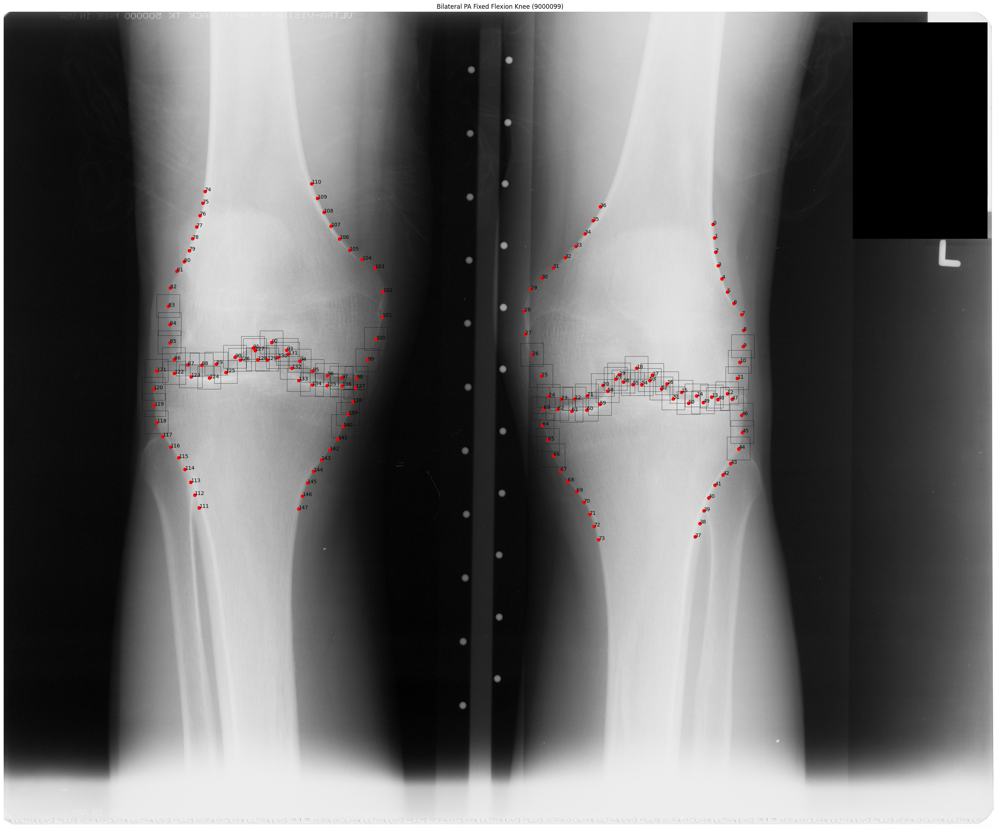

9000296 3 2
(2048, 2494)
28.81484797814018


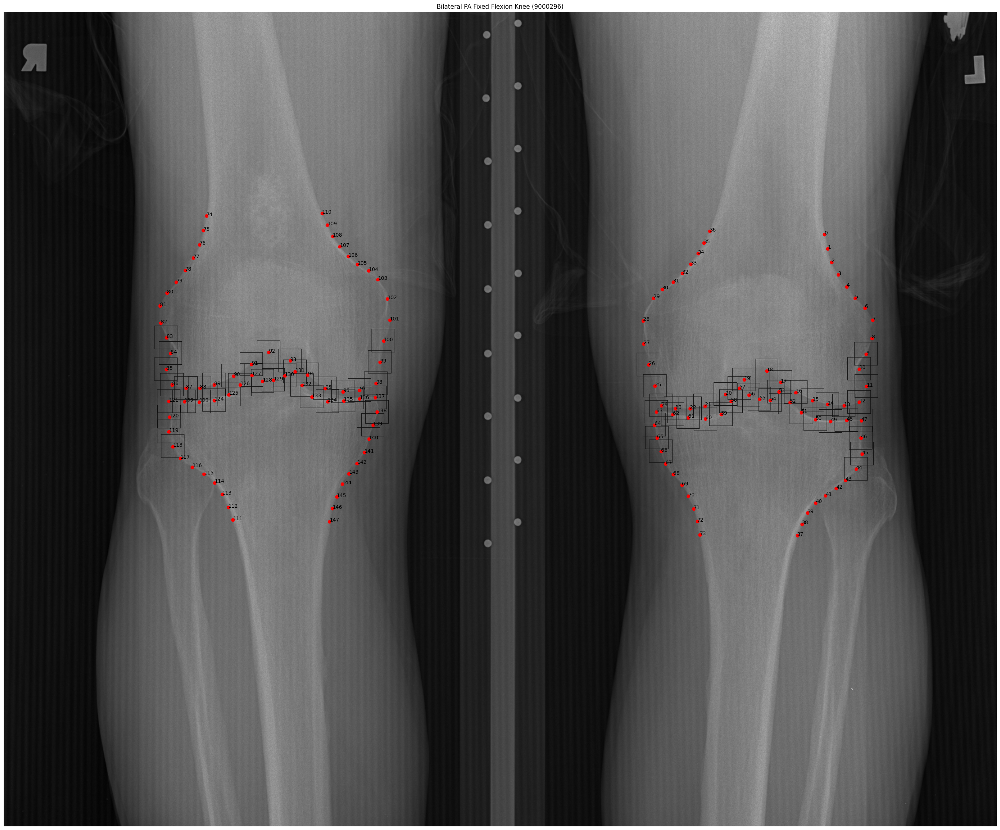

In [6]:
def patchFromPoint(point, size):
    '''
    point : the landmark
    size  : half of the length of the box (square)
    '''
    topLeft = (int(point[0] - size), int(point[1] - size))
    botRight = (int(point[0] + size), int(point[1] + size))
    return topLeft, botRight

index = 0
file_path = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index]}.dcm"
dicom_data = pydicom.dcmread(file_path)
print(patient_ids[index], kl_grades_L_np[index], kl_grades_R_np[index])

# Precompute patch intervals
range1 = np.arange(9, 27)
range2 = np.arange(44, 67)
interval = np.concatenate([range1, range2])

# 1. up + down
# 2. up + down - middle (remove some overlapped boxes)
# 3. only up

# Only copy the image once
image = dicom_data.pixel_array.copy()
print(image.shape)

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
print(size)
# Draw all rectangles on the copied image
for i in interval:
    topLeft, botRight = patchFromPoint(shapes_L_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)
    topLeft, botRight = patchFromPoint(shapes_R_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)

# Plot once at the end
plt.figure(figsize=(35, 43))
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.title(f"{dicom_data.SeriesDescription} ({patient_ids[index]})")  # Use the Series Description as title
plt.scatter(shapes_L_2d[index][:, 0], shapes_L_2d[index][:, 1], c="red")
plt.scatter(shapes_R_2d[index][:, 0], shapes_R_2d[index][:, 1], c="red")

for i in range(len(shapes_L_2d[index])):
    plt.annotate(i, (shapes_L_2d[index][i, 0], shapes_L_2d[index][i, 1]))
    plt.annotate(i + len(shapes_L_2d[index]), (shapes_R_2d[index][i, 0], shapes_R_2d[index][i, 1]))

plt.show()


index = 1
file_path = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index]}.dcm"
dicom_data = pydicom.dcmread(file_path)
print(patient_ids[index], kl_grades_L_np[index], kl_grades_R_np[index])

# Precompute patch intervals
range1 = np.arange(9, 27)
range2 = np.arange(44, 67)
interval = np.concatenate([range1, range2])

# 1. up + down
# 2. up + down - middle (remove some overlapped boxes)
# 3. only up

# Only copy the image once
image = dicom_data.pixel_array.copy()
print(image.shape)

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
print(size)
# Draw all rectangles on the copied image
for i in interval:
    topLeft, botRight = patchFromPoint(shapes_L_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)
    topLeft, botRight = patchFromPoint(shapes_R_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)

# Plot once at the end
plt.figure(figsize=(35, 43))
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.title(f"{dicom_data.SeriesDescription} ({patient_ids[index]})")  # Use the Series Description as title
plt.scatter(shapes_L_2d[index][:, 0], shapes_L_2d[index][:, 1], c="red")
plt.scatter(shapes_R_2d[index][:, 0], shapes_R_2d[index][:, 1], c="red")

for i in range(len(shapes_L_2d[index])):
    plt.annotate(i, (shapes_L_2d[index][i, 0], shapes_L_2d[index][i, 1]))
    plt.annotate(i + len(shapes_L_2d[index]), (shapes_R_2d[index][i, 0], shapes_R_2d[index][i, 1]))

plt.show()



# Contrast normalization

* I adapt the histogram truncation method used in Tiulpin et al. (2018).

50.0


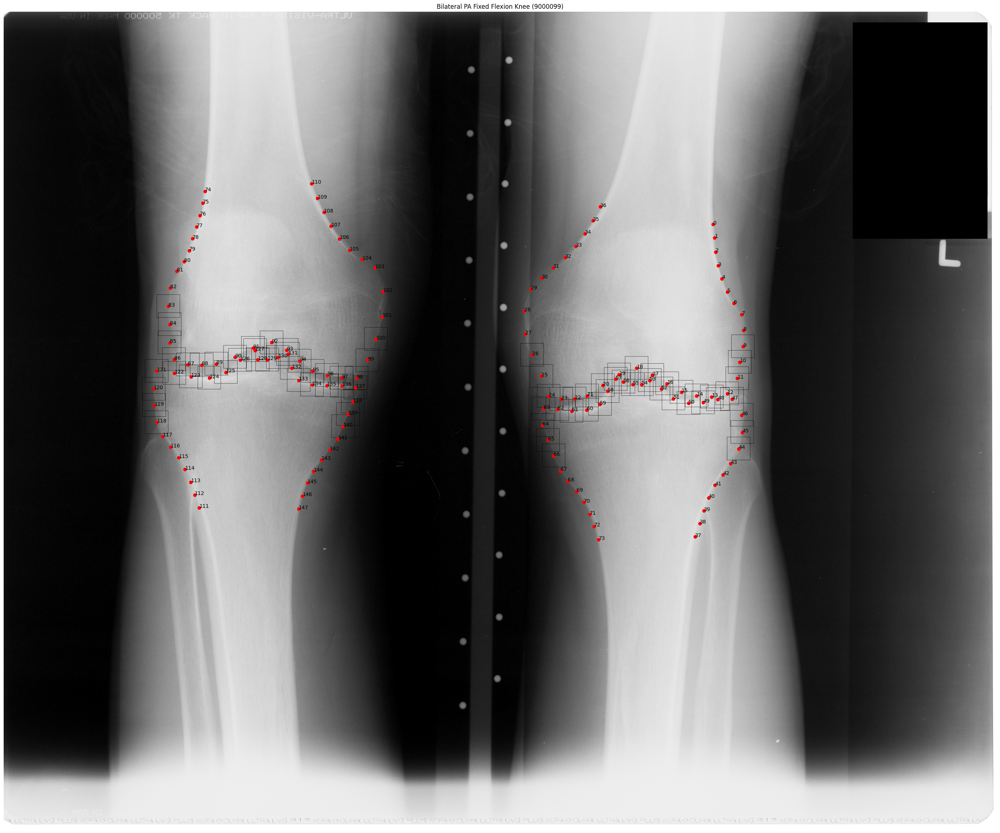

28.81484797814018


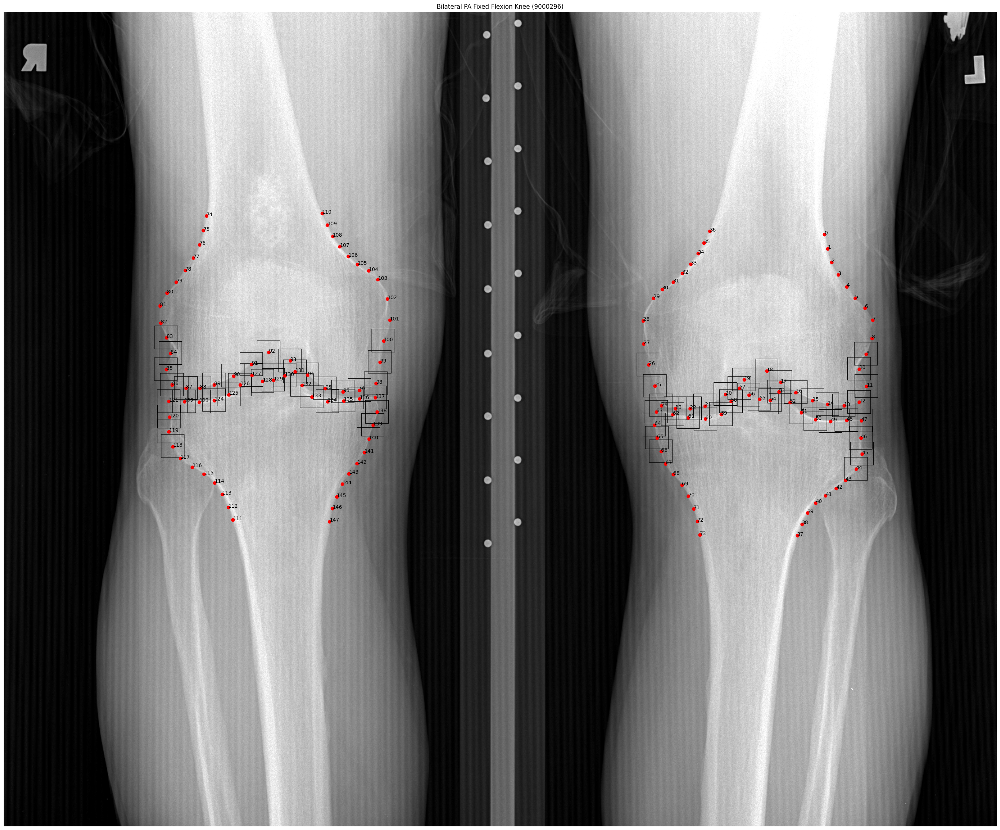

In [7]:
# Adapt from Tiulpin et al. (2018)
def process_xray(img, cut_min=5, cut_max=99, multiplier=255):
    """
    This function changes the histogram of the image by doing global contrast normalization
    
    Parameters
    ----------
    img : array_like
        Image
    cut_min : int
         Low percentile to trim
    cut_max : int
        Highest percentile trim
    multiplier : int
        Multiplier to apply after global contrast normalization
        
    Returns
    -------
    array_like
        Returns a processed image
    
    """

    img = img.copy()
    lim1, lim2 = np.percentile(img, [cut_min, cut_max])
    img[img < lim1] = lim1
    img[img > lim2] = lim2

    img -= lim1
    img /= img.max()
    img *= multiplier
    return img

index = 0

file_path = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array


image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

# image = process_xray(dicom_data.pixel_array.astype(np.float64), 5, 99, 65535)


size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
print(size)
# Draw all rectangles on the copied image
for i in interval:
    topLeft, botRight = patchFromPoint(shapes_L_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)
    topLeft, botRight = patchFromPoint(shapes_R_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)

# Plot once at the end
plt.figure(figsize=(35, 43))
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.title(f"{dicom_data.SeriesDescription} ({patient_ids[index]})")  # Use the Series Description as title
plt.scatter(shapes_L_2d[index][:, 0], shapes_L_2d[index][:, 1], c="red")
plt.scatter(shapes_R_2d[index][:, 0], shapes_R_2d[index][:, 1], c="red")

for i in range(len(shapes_L_2d[index])):
    plt.annotate(i, (shapes_L_2d[index][i, 0], shapes_L_2d[index][i, 1]))
    plt.annotate(i + len(shapes_L_2d[index]), (shapes_R_2d[index][i, 0], shapes_R_2d[index][i, 1]))

plt.show()



index = 1

file_path = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array


image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
print(size)
# Draw all rectangles on the copied image
for i in interval:
    topLeft, botRight = patchFromPoint(shapes_L_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)
    topLeft, botRight = patchFromPoint(shapes_R_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)

# Plot once at the end
plt.figure(figsize=(35, 43))
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.title(f"{dicom_data.SeriesDescription} ({patient_ids[index]})")  # Use the Series Description as title
plt.scatter(shapes_L_2d[index][:, 0], shapes_L_2d[index][:, 1], c="red")
plt.scatter(shapes_R_2d[index][:, 0], shapes_R_2d[index][:, 1], c="red")

for i in range(len(shapes_L_2d[index])):
    plt.annotate(i, (shapes_L_2d[index][i, 0], shapes_L_2d[index][i, 1]))
    plt.annotate(i + len(shapes_L_2d[index]), (shapes_R_2d[index][i, 0], shapes_R_2d[index][i, 1]))

plt.show()


# Visualize the patches

* Note that in Tiulpin et al. (2018), the large patch pairs used for training have dimensions of 128 × 128 pixels.
* To improve computational efficiency (at least more efficient than Tiulpin's), I decided to reduce our patch size to 16 × 16 pixels.
    * This resizing step reduces the input resolution while keeping the spatial coverage of each patch fixed.
    * In follow-up experiments, I found that downsampling to 16 × 16 helps reduce noise and improves performance.
    * In contrast, 32 × 32 resolution performs worse—likely because it retains more irrelevant local variations or artifacts that act as noise.

In [8]:
# bad x-ray image
index = np.where(np.array(patient_ids) == "9491446")[0][0]
print(patient_ids[index], kl_grades_L_np[index], kl_grades_R_np[index])
side = "L"

9491446 0 0


9000099 3 2
50.0


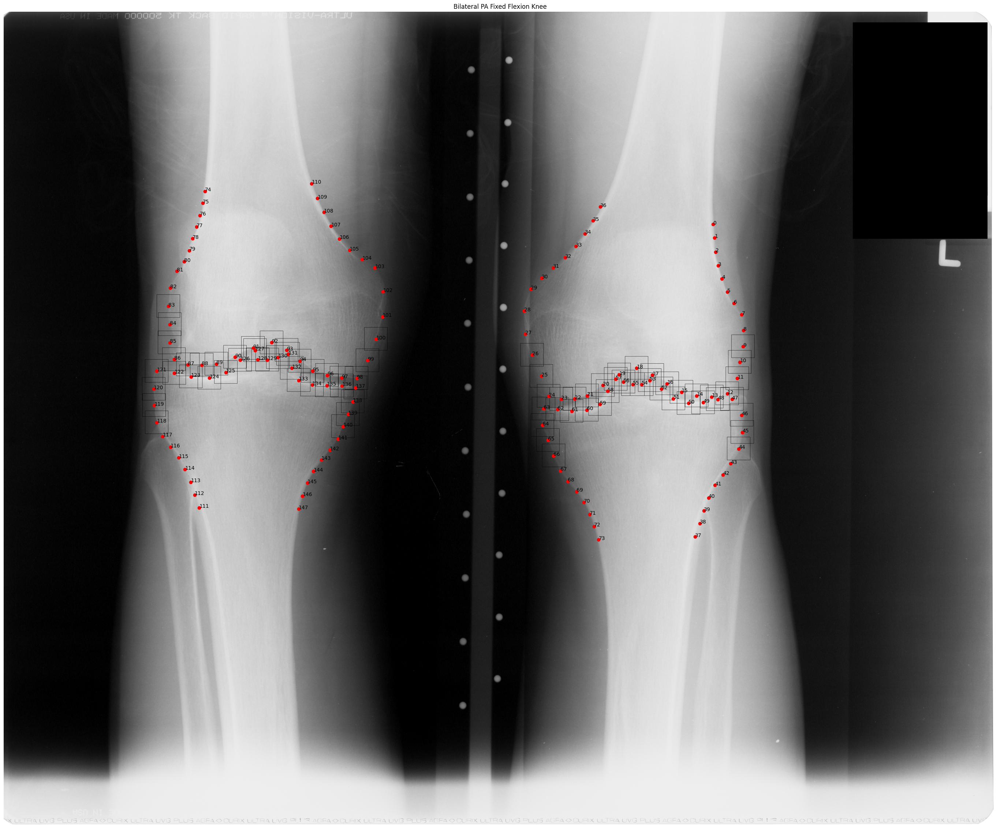

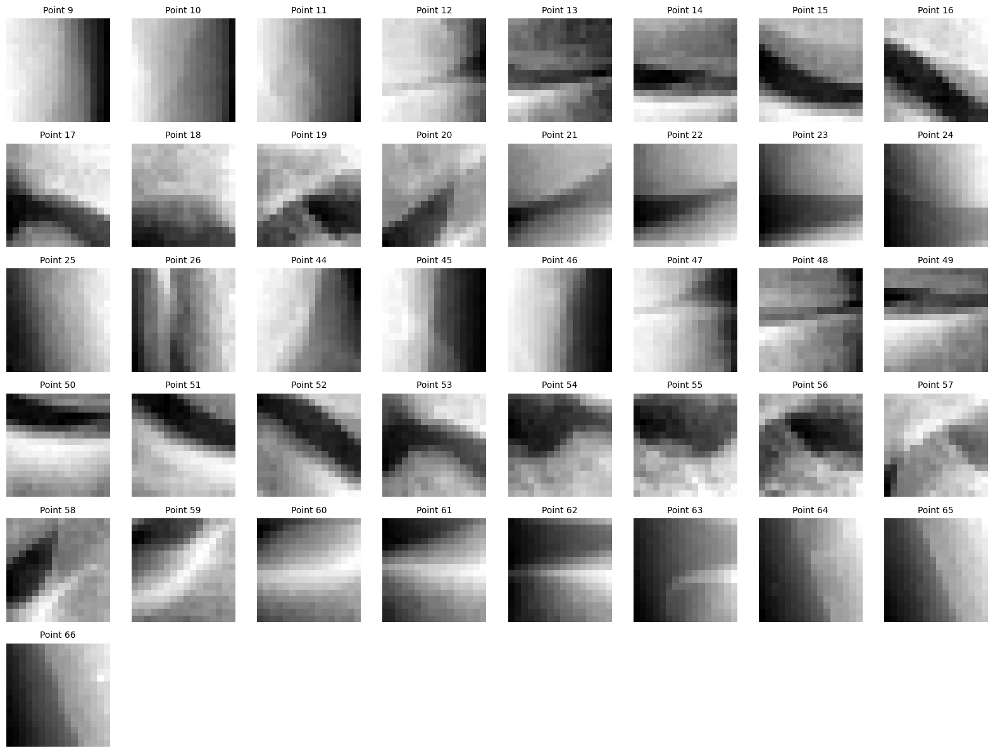

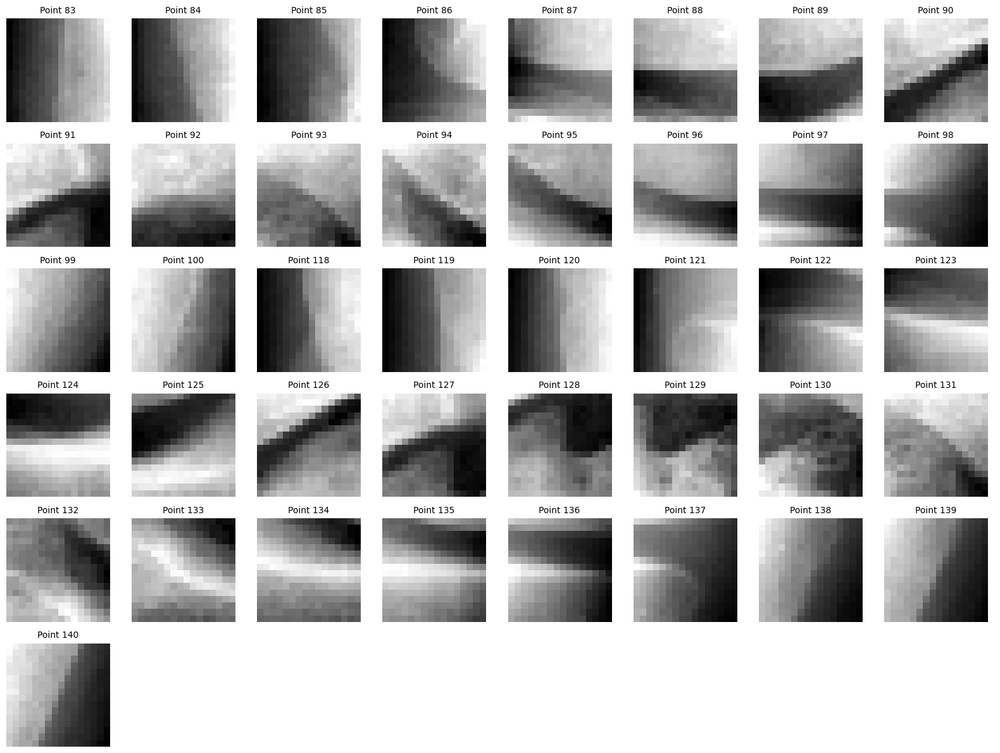

In [11]:
import math
index = 0
print(patient_ids[index], kl_grades_L_np[index], kl_grades_R_np[index])

file_path = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee\{patient_ids[index]}.dcm"
dicom_data = pydicom.dcmread(file_path)
image = dicom_data.pixel_array  # Get image pixel array


image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

size = np.sqrt((100 * 100) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2
# size = np.sqrt((128 * 128) / (3560 * 4320)) * np.sqrt(image.shape[0]*image.shape[1]) / 2

print(size)

# Draw all rectangles on the copied image
range1 = np.arange(9, 27)
range2 = np.arange(44, 67)
interval = np.concatenate([range1, range2])
for id, i in enumerate(interval):
    topLeft, botRight = patchFromPoint(shapes_L_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)

    topLeft, botRight = patchFromPoint(shapes_R_2d[index][i], size=size)
    cv2.rectangle(image, topLeft, botRight, color=(255), thickness=1)

# Plot once at the end
plt.figure(figsize=(35, 43))
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.title(dicom_data.SeriesDescription)
plt.scatter(shapes_L_2d[index][:, 0], shapes_L_2d[index][:, 1], c="red")
plt.scatter(shapes_R_2d[index][:, 0], shapes_R_2d[index][:, 1], c="red")

for i in range(len(shapes_L_2d[index])):
    plt.annotate(i, (shapes_L_2d[index][i, 0], shapes_L_2d[index][i, 1]))
    plt.annotate(i + len(shapes_L_2d[index]), (shapes_R_2d[index][i, 0], shapes_R_2d[index][i, 1]))

plt.show()






# crop and resize to, e.g., 16 x 16 or 28 x 28

patches_right = []
patches_left = []
target_size = (16, 16)  # Desired output size for each patch

def crop_patch(image, topLeft, botRight):
    x1, y1 = topLeft[0], topLeft[1]
    x2, y2 = botRight[0], botRight[1]
    patch = image[y1:y2, x1:x2]  # Note: (y, x) order for slicing
    return patch

# renew image
image = np.frombuffer(dicom_data.pixel_array.copy(), dtype=np.uint16).copy().astype(np.float64)
image = process_xray(image, 5, 99, 65535)
image = image.reshape((dicom_data.Rows, dicom_data.Columns))

# For both left and right shapes
for i in interval:
    # Left knee
    topLeft, botRight = patchFromPoint(shapes_L_2d[index][i], size=size)
    patch = crop_patch(image, topLeft, botRight)
    resized_patch = cv2.resize(patch, target_size, interpolation=cv2.INTER_AREA)
    patches_left.append(resized_patch)

    # Right knee
    topLeft, botRight = patchFromPoint(shapes_R_2d[index][i], size=size)
    patch = crop_patch(image, topLeft, botRight)
    resized_patch = cv2.resize(patch, target_size, interpolation=cv2.INTER_AREA)
    patches_right.append(resized_patch)




# Left
# Convert to NumPy array (if not already)
patches_array = np.stack(patches_left)  # Shape: (N, 64, 64)

# Determine grid size
n_patches = len(patches_array)
n_cols = 8  # You can change this
n_rows = math.ceil(n_patches / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

for idx, patch in enumerate(patches_array):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.imshow(patch, cmap='gray')
    ax.set_title(f"Point {interval[idx]}", fontsize=10)  # Add title
    ax.axis('off')

# Hide any unused axes
for idx in range(n_patches, n_rows * n_cols):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

# Right
# Convert to NumPy array (if not already)
patches_array = np.stack(patches_right)  # Shape: (N, 64, 64)

# Determine grid size
n_patches = len(patches_array)
n_cols = 8  # You can change this
n_rows = math.ceil(n_patches / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

for idx, patch in enumerate(patches_array):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.imshow(patch, cmap='gray')
    ax.set_title(f"Point {interval[idx]+74}", fontsize=10)  # Add title
    ax.axis('off')

# Hide any unused axes
for idx in range(n_patches, n_rows * n_cols):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.axis('off')

plt.tight_layout()
plt.show()



# Flip left knee (patches)

* Flip left knee as Tiulpin et al. (2018) did 

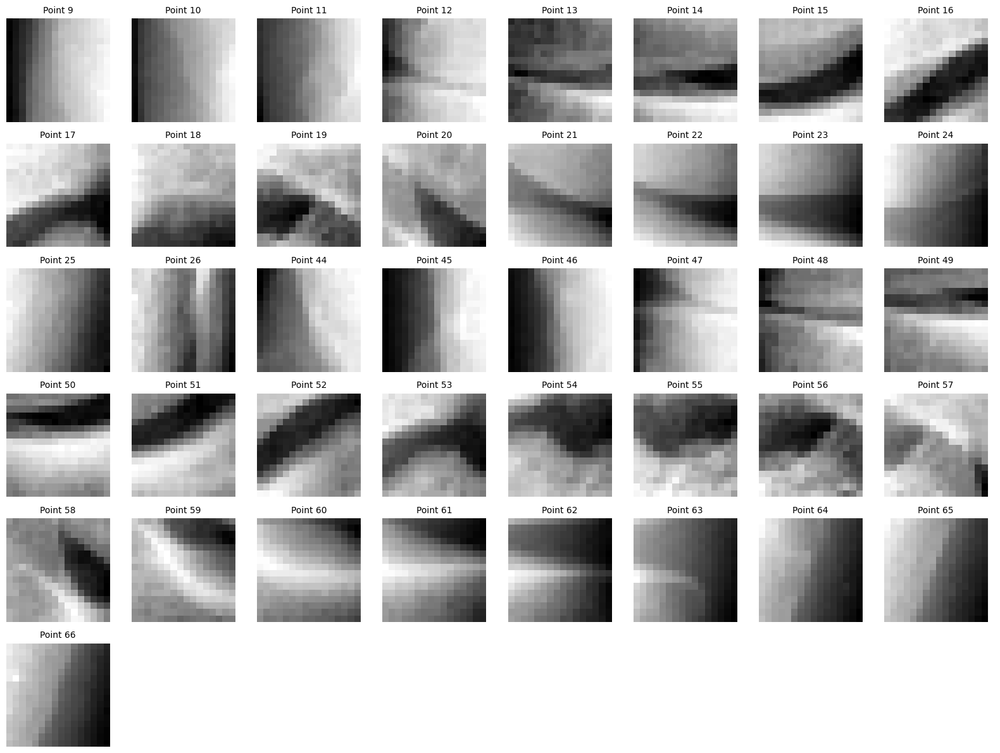

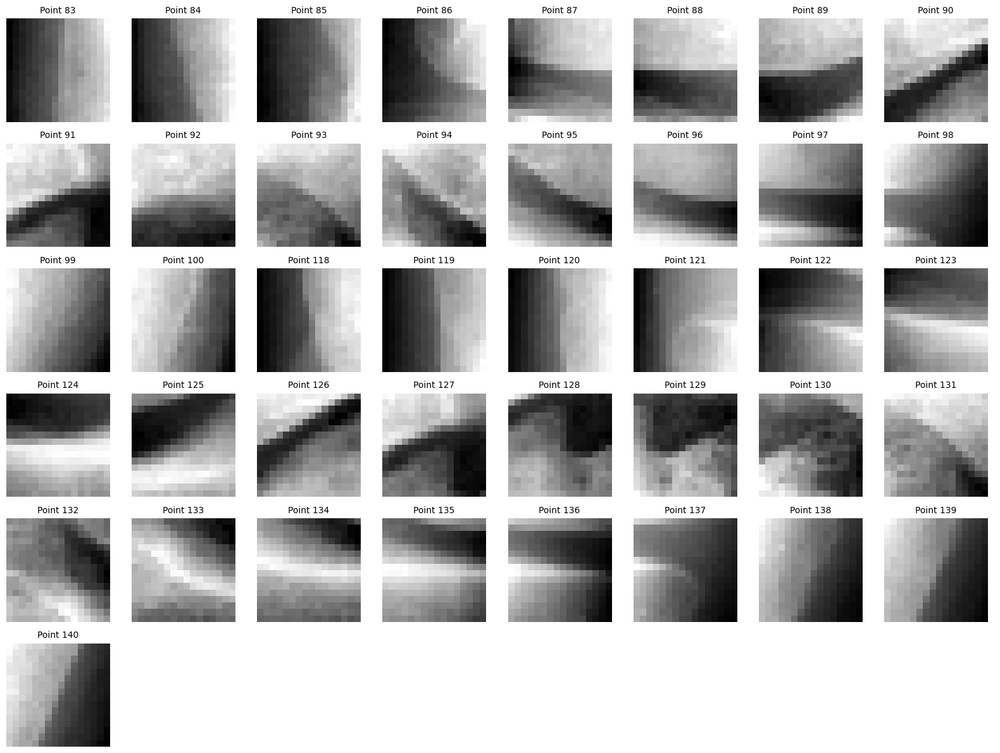

In [12]:
# visualize left fipped patches and compare them to right patches
# Left
# Convert to NumPy array (if not already)
patches_array = np.stack(patches_left)  # Shape: (N, 64, 64)

# Determine grid size
n_patches = len(patches_array)
n_cols = 8  # You can change this
n_rows = math.ceil(n_patches / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

for idx, patch in enumerate(patches_array):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    patch = np.fliplr(patch) 
    ax.imshow(patch, cmap='gray')
    ax.set_title(f"Point {interval[idx]}", fontsize=10)  # Add title
    ax.axis('off')

# Hide any unused axes
for idx in range(n_patches, n_rows * n_cols):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.axis('off')

plt.tight_layout()
plt.show()

# Right
# Convert to NumPy array (if not already)
patches_array = np.stack(patches_right)  # Shape: (N, 64, 64)

# Determine grid size
n_patches = len(patches_array)
n_cols = 8  # You can change this
n_rows = math.ceil(n_patches / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

for idx, patch in enumerate(patches_array):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.imshow(patch, cmap='gray')
    ax.set_title(f"Point {interval[idx]+74}", fontsize=10)  # Add title
    ax.axis('off')

# Hide any unused axes
for idx in range(n_patches, n_rows * n_cols):
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    ax.axis('off')

plt.tight_layout()
plt.show()


# Save the patch data and label into .h5 file

In [13]:
import h5py
import numpy as np
import pydicom
import cv2
import os

OUTPUT_HDF5_PATIENT_GROUPED_FILE = r"D:\V00\knee_patches_patient_grouped_16_100.h5"
BASE_DICOM_PATH = rf"D:\V00\Bilateral_PA_Fixed_Flexion_Knee"
TARGET_PATCH_SIZE = (16, 16)

# Define the interval of point indices to use for patches
# This is constant, so define it outside the loop
range1 = np.arange(9, 27)  # Indices 9 to 26
range2 = np.arange(44, 67) # Indices 44 to 66
PATCH_POINT_INDICES = np.concatenate([range1, range2])

# sub_patient_ids = patient_ids[:250] # Or however many you intend to process

print(f"Processing {len(patient_ids)} patients for grouped HDF5...")

def create_patches_for_knee(processed_image, shapes, point_indices_to_use,
                            patch_side_length, target_size, horizontally_flip=False):
    """Helper function to create patches for a single knee."""
    patches_collected = []
    successful_point_indices = [] # Store indices of points that resulted in a patch

    for point_i in point_indices_to_use:
        if point_i >= len(shapes): # Check if point_i is a valid index for the current patient's shapes
            # print(f"    Warning: Point index {point_i} is out of bounds for shapes (len: {len(shapes)}). Skipping.")
            continue

        center = shapes[point_i]
        topLeft, botRight = patchFromPoint(center, size=patch_side_length)
        patch_raw = crop_patch(processed_image, topLeft, botRight)

        if patch_raw is not None and patch_raw.size > 0:
            resized_patch = cv2.resize(patch_raw, target_size, interpolation=cv2.INTER_AREA)
            if horizontally_flip:
                resized_patch = np.fliplr(resized_patch)
            patches_collected.append(resized_patch)
            successful_point_indices.append(point_i)
    return patches_collected, successful_point_indices


with h5py.File(OUTPUT_HDF5_PATIENT_GROUPED_FILE, 'w') as hf:
    dt = h5py.string_dtype(encoding='utf-8')
    hf.create_dataset('patient_ids_order', data=np.array(patient_ids, dtype=dt))
    # Store the global patch point indices used
    hf.create_dataset('global_patch_point_indices_definition', data=PATCH_POINT_INDICES)


    for patient_idx, patient_id_str in enumerate(patient_ids):
        # Simple progress indicator
        print(f"  Processing patient {patient_idx + 1}/{len(patient_ids)}: {patient_id_str}")

        try:
            file_path = os.path.join(BASE_DICOM_PATH, f"{patient_id_str}.dcm")
            dicom_data = pydicom.dcmread(file_path)
            image_raw = dicom_data.pixel_array.astype(np.float64)
        except FileNotFoundError:
            print(f"    ERROR: DICOM file not found for {patient_id_str} at {file_path}. Skipping.")
            continue
        except Exception as e:
            print(f"    ERROR: Could not read or process DICOM for {patient_id_str}: {e}. Skipping.")
            continue

        processed_image = process_xray(image_raw, 5, 99, 65535)
        img_h, img_w = image_raw.shape
        # Assuming patchFromPoint expects radius or half-width due to your original /2
        # patch_half_width = (np.sqrt(100*100) / np.sqrt(3560*4320)) * np.sqrt(img_h*img_w) / 2
        patch_half_width = (np.sqrt(128*128) / np.sqrt(3560*4320)) * np.sqrt(img_h*img_w) / 2

        current_shapes_L = shapes_L_2d[patient_idx]
        current_shapes_R = shapes_R_2d[patient_idx]
        current_kl_grade_L = kl_grades_L_np[patient_idx]
        current_kl_grade_R = kl_grades_R_np[patient_idx]

        # --- Process and Save Left Knee ---
        if current_kl_grade_L != -999:
            patient_patches_L, successful_point_indices_L = create_patches_for_knee(
                processed_image, current_shapes_L, PATCH_POINT_INDICES,
                patch_half_width, TARGET_PATCH_SIZE, horizontally_flip=True
            )

            if patient_patches_L:
                patient_patches_np_L = np.array(patient_patches_L, dtype=np.float32)
                patient_patches_np_L = np.expand_dims(patient_patches_np_L, axis=-1)
            else:
                patient_patches_np_L = np.zeros((0, TARGET_PATCH_SIZE[0], TARGET_PATCH_SIZE[1], 1), dtype=np.float32)

            patient_group_L = hf.create_group(patient_id_str + "_L")
            patient_group_L.create_dataset('patches', data=patient_patches_np_L, compression="gzip")
            patient_group_L.create_dataset('kl_grade', data=np.array([current_kl_grade_L], dtype=np.int32))
            # Save the actual point indices corresponding to the saved patches
            patient_group_L.create_dataset('patch_source_point_indices', data=np.array(successful_point_indices_L, dtype=np.int32))
            # Optional: print only if verbose or for debugging
            print(f"    Stored {patient_patches_np_L.shape[0]} patches for patient {patient_id_str}'s left knee with KL {current_kl_grade_L}")

        # --- Process and Save Right Knee ---
        if current_kl_grade_R != -999:
            patient_patches_R, successful_point_indices_R = create_patches_for_knee(
                processed_image, current_shapes_R, PATCH_POINT_INDICES,
                patch_half_width, TARGET_PATCH_SIZE, horizontally_flip=False
            )

            if patient_patches_R:
                patient_patches_np_R = np.array(patient_patches_R, dtype=np.float32)
                patient_patches_np_R = np.expand_dims(patient_patches_np_R, axis=-1)
            else:
                patient_patches_np_R = np.zeros((0, TARGET_PATCH_SIZE[0], TARGET_PATCH_SIZE[1], 1), dtype=np.float32)

            patient_group_R = hf.create_group(patient_id_str + "_R")
            patient_group_R.create_dataset('patches', data=patient_patches_np_R, compression="gzip")
            patient_group_R.create_dataset('kl_grade', data=np.array([current_kl_grade_R], dtype=np.int32))
            # For right knee, if you want to map these indices to a global landmark scheme
            # where right knee landmarks start after left, you can adjust them here or during loading.
            # Original point indices for right shapes:
            patient_group_R.create_dataset('patch_source_point_indices', data=np.array(successful_point_indices_R, dtype=np.int32))
            # If you had a global scheme like `interval+74`:
            # global_point_indices_R = [idx + 74 for idx in successful_point_indices_R] # Assuming 74 is the offset for right knee points
            # patient_group_R.create_dataset('patch_source_global_point_indices', data=np.array(global_point_indices_R, dtype=np.int32))

            # Optional: print only if verbose or for debugging
            print(f"    Stored {patient_patches_np_R.shape[0]} patches for patient {patient_id_str}'s right knee with KL {current_kl_grade_R}")

    print(f"Patient-grouped data saved to {OUTPUT_HDF5_PATIENT_GROUPED_FILE}")

Processing 4794 patients for grouped HDF5...
  Processing patient 1/4794: 9000099
    Stored 41 patches for patient 9000099's left knee with KL 3
    Stored 41 patches for patient 9000099's right knee with KL 2
  Processing patient 2/4794: 9000296
    Stored 41 patches for patient 9000296's left knee with KL 3
    Stored 41 patches for patient 9000296's right knee with KL 2
  Processing patient 3/4794: 9000622
    Stored 41 patches for patient 9000622's left knee with KL 1
    Stored 41 patches for patient 9000622's right knee with KL 1
  Processing patient 4/4794: 9000798
    Stored 41 patches for patient 9000798's left knee with KL 4
    Stored 41 patches for patient 9000798's right knee with KL 1
  Processing patient 5/4794: 9001104
    Stored 41 patches for patient 9001104's left knee with KL 1
    Stored 41 patches for patient 9001104's right knee with KL 3
  Processing patient 6/4794: 9001400
    Stored 41 patches for patient 9001400's left knee with KL 1
    Stored 41 patches fo

KeyboardInterrupt: 